In [ ]:
#RUN THIS CELL 
import requests
from IPython.core.display import HTML
# styles = requests.get("https://raw.githubusercontent.com/Harvard-IACS/2018-CS109A/master/content/styles/cs109.css").text
# HTML(styles)

In [ ]:
#RUN THIS CELL
import os
import pathlib

working_dir = pathlib.Path().absolute()
os.chdir(working_dir)

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib
import datetime
import matplotlib.pyplot as plt
%matplotlib inline

import pandas as pd
import geopandas
import shapely
from urllib.request import urlopen
import json
#import shapefile
import plotly
from urllib.request import urlopen
from plotly.figure_factory._county_choropleth import create_choropleth
import plotly.express as px
from plotly.subplots import make_subplots
#import cufflinks as cf
from plotly.offline import download_plotlyjs, plot,iplot
import plotly.graph_objects as go

In [ ]:
from matplotlib import dates as mdates

# Visualize Different Data Set

## 1. COVID cases

In [ ]:
# load counties
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

# Load population data
population = pd.read_csv("/home/jovyan/work/Covid-19-Prediction/data/covid_county_population_usafacts.csv")
population = population[(population['countyFIPS'] != 0) & (population['countyFIPS'] != 6000)]
population['fip'] = population['countyFIPS'].apply(lambda x: str(x).zfill(5))
population['population_draw'] = population['population']/10000
population.head()

,countyFIPS,County Name,State,population,fip,population_draw
1,1001,Autauga County,AL,55869,01001,5.5869
2,1003,Baldwin County,AL,223234,01003,22.3234
3,1005,Barbour County,AL,24686,01005,2.4686
4,1007,Bibb County,AL,22394,01007,2.2394
5,1009,Blount County,AL,57826,01009,5.7826


In [ ]:
# population data visualization
fig = px.choropleth(population, 
                    geojson=counties, 
                    locations='fip', color='population_draw',
                           #color_continuous_scale="Viridis",
                           range_color=(0, 50),
                           scope="usa",
                           labels={'unemp':'unemployment rate'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [ ]:
# load case data
case = pd.read_csv("/home/jovyan/work/Covid-19-Prediction/data/covid_confirmed_usafacts_new.csv")
case['fip'] = case['countyFIPS'].apply(lambda x: str(x).zfill(5))
case.head()

,countyFIPS,County Name,State,stateFIPS,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,...,11/1/20,11/2/20,11/3/20,11/4/20,11/5/20,11/6/20,11/7/20,11/8/20,11/9/20,fip
0,0,Statewide Unallocated,AL,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,00000
1,1001,Autauga County,AL,1,0,0,0,0,0,0,...,2173,2186,2197,2212,2230,2242,2267,2283,2304,01001
2,1003,Baldwin County,AL,1,0,0,0,0,0,0,...,6966,6985,6995,7061,7097,7134,7188,7226,7263,01003
3,1005,Barbour County,AL,1,0,0,0,0,0,0,...,1061,1065,1074,1079,1080,1090,1092,1095,1098,01005
4,1007,Bibb County,AL,1,0,0,0,0,0,0,...,878,883,890,897,907,917,924,926,932,01007


In [ ]:
# case data preprocessing
month_3 = case.columns.get_loc("3/1/20")
month_4 = case.columns.get_loc("4/1/20")
month_5 = case.columns.get_loc("5/1/20")
month_6 = case.columns.get_loc("6/1/20")
month_7 = case.columns.get_loc("7/1/20")
month_8 = case.columns.get_loc("8/1/20")
month_9 = case.columns.get_loc("9/1/20")
case['March'] = case.iloc[:,month_3:month_4].mean(axis=1)
case['April'] = case.iloc[:,month_4:month_5].mean(axis=1)
case['May'] = case.iloc[:,month_5:month_6].mean(axis=1)
case['June'] = case.iloc[:,month_6:month_7].mean(axis=1)
case['July'] = case.iloc[:,month_7:month_8].mean(axis=1)
case['August'] = case.iloc[:,month_8:month_9].mean(axis=1)
case.head()

,countyFIPS,County Name,State,stateFIPS,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,...,11/7/20,11/8/20,11/9/20,fip,March,April,May,June,July,August
0,0,Statewide Unallocated,AL,1,0,0,0,0,0,0,...,0,0,0,00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,1001,Autauga County,AL,1,0,0,0,0,0,0,...,2267,2283,2304,01001,1.387097,24.300000,118.161290,369.433333,781.548387,1250.580645
2,1003,Baldwin County,AL,1,0,0,0,0,0,0,...,7188,7226,7263,01003,3.096774,95.900000,241.677419,403.433333,1754.903226,3879.419355
3,1005,Barbour County,AL,1,0,0,0,0,0,0,...,1092,1095,1098,01005,0.000000,16.866667,85.516129,243.866667,456.516129,672.645161
4,1007,Bibb County,AL,1,0,0,0,0,0,0,...,924,926,932,01007,0.161290,21.833333,52.612903,113.033333,256.580645,475.483871


In [ ]:
fig = px.choropleth(case, 
                        geojson=counties, 
                        locations='fip', color='month_3',
                               #color_continuous_scale="Viridis",
                               range_color=(0, 5000),
                               scope="usa",
                               labels={'confirmed cases':month}
                              )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

NameError: name 'month' is not defined

In [ ]:
! pip install -U kaleido

     |████████████████████████████████| 74.0 MB 186 kB/s 


In [ ]:
import psutil
months = ['March', 'April', 'May','June', 'July', 'August']
for month in months:
    fig = px.choropleth(case, 
                        geojson=counties, 
                        locations='fip', color=month,
                               #color_continuous_scale="Viridis",
                               range_color=(0, 5000),
                               scope="usa",
                               labels={'confirmed cases':month}
                              )
    fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
    fig.show()

ModuleNotFoundError: No module named 'psutil'

In [ ]:
case_state = case.drop(['month_3', 'month_4', 'month_5','month_6', 'month_7', 'month_8', 'countyFIPS', 'County Name'], axis = 1).groupby(by = 'State').sum()
case_state_num = case_state.drop('stateFIPS', axis = 1)
case_state_date = list(case_state.columns)
case_state_date.pop(0)
case_state_date = list(map(datetime.datetime.strptime, case_state_date, len(case_state_date)*['%m/%d/%y']))
case_state_name = list(case_state.index)
#plt.plot(case_state_date, case_state_num.iloc[0,:])
 

KeyError: "['month_3' 'month_4' 'month_5' 'month_6' 'month_7' 'month_8'] not found in axis"

NameError: name 'case_state_name' is not defined

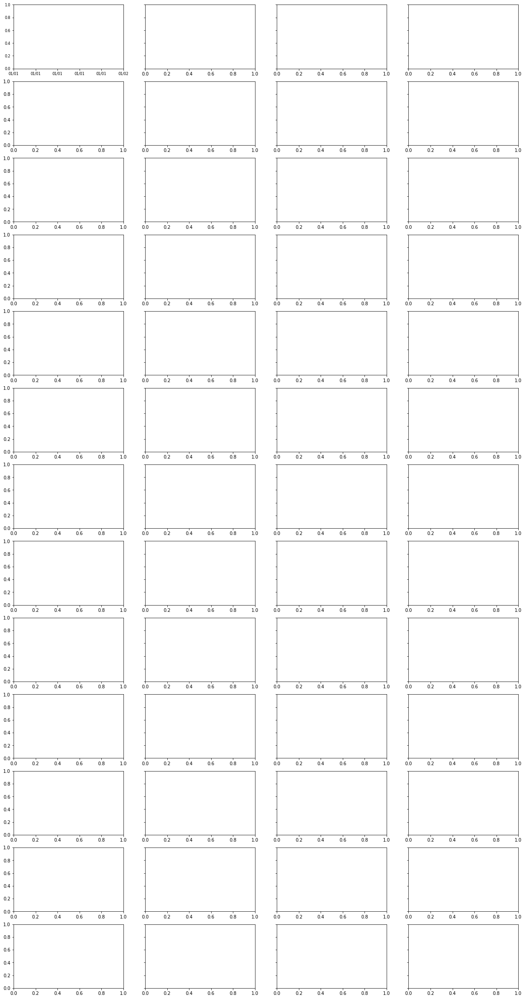

In [ ]:
# Time-series visualization for the US and each state

fig, axs = plt.subplots(13, 4, figsize = (20,40),sharey='row')
i = 0

for ax in axs.ravel()[0:51]:
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%m/%d'))
    # ax.grid(True)
    # ax.set_ylabel(labels[i], fontsize=8, color="blue")
    ax.tick_params(axis='both', which='major', labelsize=8)
    #if i == 0:
        # plot national trend
        #cur_df = visual_data["national_2020"]
        #prev_df = visual_data["national_2019"]
        #ax.set_title("National Trend")
    #else:
    #cur_df = cur_state[cur_state["state_code"] == state_names[i-1]]
    #prev_df = prev_state[prev_state["state_code"] == state_names[i-1]]
    ax.set_title("%s"%(str(case_state_name[i])))

    # ax.plot(dates, cur_df['avg_stay_at_home_ratio'], label = "daily")
    ax.plot(case_state_date, case_state_num.iloc[i,:])
    #ax.plot(converted_dates, prev_df["MA_7"], label = '2019')
    #ax.legend(loc = "upper right")
    ax.set_ylabel("new confirmed cases")
      
    i += 1
     
plt.tight_layout()
fig.savefig("../graphs/new confirmed cases")

## 2. Social Distance Data

In [ ]:
# Import social distance data

sd_data_folder_path = '../data/distance_data/'
data_names = ["national_2019", "state_2019", "county_2019",
             "national_2020", "state_2020", "county_2020"]
data_all = {}
for data_name in data_names:
    data = pd.read_csv(sd_data_folder_path+"%s.csv"%(data_name))
    
    data_all[data_name] = data
    print(data_name, data.shape)

national_2019 (304, 24)
state_2019 (15504, 24)
county_2019 (955168, 24)
national_2020 (305, 24)
state_2020 (15555, 24)
county_2020 (958310, 24)


In [ ]:
# To compare 2019 and 2020, we need to drop Feb 29, 2020
visual_data = {}
for data_name in data_names:
    df = data_all[data_name]
    df = df[df["only_date"]!="02/29"]
    
    visual_data[data_name] = df
    print(data_name, df.shape)

national_2019 (304, 24)
state_2019 (15504, 24)
county_2019 (955168, 24)
national_2020 (304, 24)
state_2020 (15504, 24)
county_2020 (955168, 24)


In [ ]:
# Choose dataset for time-series visualization

cur_state = visual_data["state_2020"]
prev_state = visual_data["state_2019"]

state_names = visual_data["state_2020"]["state_code"].unique()

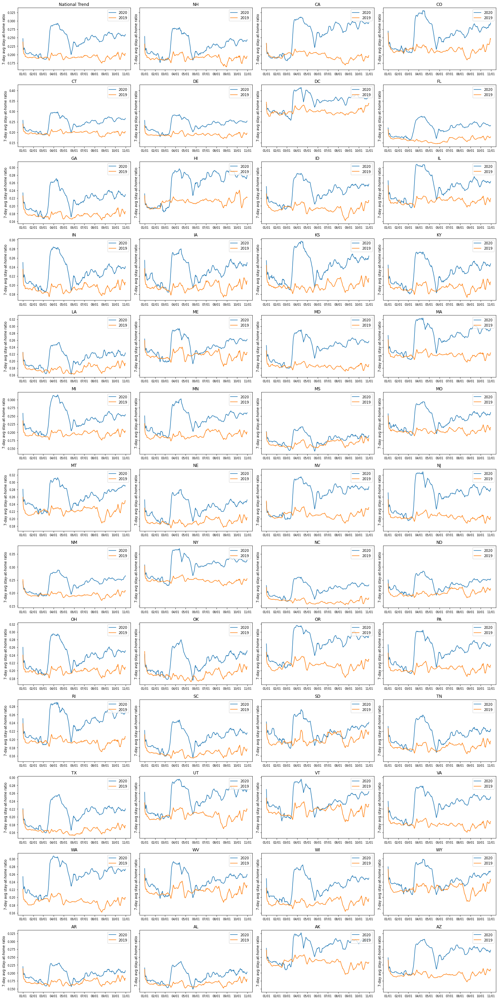

In [ ]:
# Time-series visualization for the US and each state

converted_dates = list(map(datetime.datetime.strptime, visual_data["national_2020"]["date"].values, len(visual_data["national_2020"]["date"].values)*['%Y-%m-%d']))

fig, axs = plt.subplots(13, 4, figsize = (20,40),sharey='row')
i = 0

for ax in axs.ravel():
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%m/%d'))
    # ax.grid(True)
    # ax.set_ylabel(labels[i], fontsize=8, color="blue")
    ax.tick_params(axis='both', which='major', labelsize=8)
    if i == 0:
        # plot national trend
        cur_df = visual_data["national_2020"]
        prev_df = visual_data["national_2019"]
        ax.set_title("National Trend")
    else:
        cur_df = cur_state[cur_state["state_code"] == state_names[i-1]]
        prev_df = prev_state[prev_state["state_code"] == state_names[i-1]]
        ax.set_title("%s"%(str(state_names[i-1])))

    # ax.plot(dates, cur_df['avg_stay_at_home_ratio'], label = "daily")
    ax.plot(converted_dates, cur_df["MA_7"], label = '2020')
    ax.plot(converted_dates, prev_df["MA_7"], label = '2019')
    ax.legend(loc = "upper right")
    ax.set_ylabel("7-day avg stay-at-home ratio")
      
    i += 1
     
plt.tight_layout()
fig.savefig("../graphs/avg SAT ratio for states 2 years.png")

In [ ]:
# Change fips from float to string

data_all["county_2020"]['county_fips'] = data_all["county_2020"]['county_fips'].apply(lambda x: str(int(x)).zfill(5))
data_all["county_2019"]['county_fips'] = data_all["county_2019"]['county_fips'].apply(lambda x: str(int(x)).zfill(5))

In [ ]:
# Calculate ratio of different types of trips
dist_agg = {}
for data_name in data_names:
    df = data_all[data_name] 
    df["trip_ratio"] = df["trips"]/df["pop"]
    df["short_trips"] = df["trips_1"] + df["trips_1_3"] + df["trips_3_5"] + df["trips_5_10"]
    df["med_trips"] = df["trips_10_25"] + df["trips_25_50"] + df["trips_25_50"] 
    df["long_trips"] = + df["trips_50_100"] + df["trips_100_250"] + df["trips_250_500"] + df["trips_500"] 

    df["short_trip_ratio"] = df["short_trips"]/df["trips"]
    df["med_trip_ratio"] = df["med_trips"]/df["trips"]
    df["long_trip_ratio"] = df["long_trips"]/df["trips"]

    dist_agg[data_name] = df[['date', 'state_fips', 'state_code', 
                              'county_fips', 'county',
                              'pop_stay_at_home', 'pop_not_stay_at_home', 
                              'trip_ratio',"short_trip_ratio",
                              "med_trip_ratio", "long_trip_ratio",
                              "only_date", "weekday",
                              "avg_stay_at_home_ratio","MA_7"]]


In [ ]:
county_daily_avg = dist_agg["county_2020"].groupby(by = ["county_fips"], as_index = False).mean()
county_daily_avg.head(1)


,county_fips,state_fips,pop_stay_at_home,pop_not_stay_at_home,trip_ratio,short_trip_ratio,med_trip_ratio,long_trip_ratio,weekday,avg_stay_at_home_ratio,MA_7
0,01001,1.0,9723.537705,45877.462295,3.145253,0.74123,0.275765,0.027315,3.006557,0.174881,0.174785


In [ ]:
# avereage number of trips taken by everyone daily
fig = px.choropleth(county_daily_avg, 
                    geojson=counties, 
                    color_continuous_scale="balance",
                    locations='county_fips', color='trip_ratio',
                    range_color=(0, np.max(county_daily_avg["trip_ratio"])),
                    scope="usa",
                    #labels={'unemp':'unemployment rate'}
                    )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [ ]:
# average ratio of long trips for everyone in the county
fig = px.choropleth(county_daily_avg, 
                    geojson=counties, 
                    color_continuous_scale="balance",
                    locations='county_fips', color='long_trip_ratio',
                    range_color=(0, np.max(county_daily_avg["long_trip_ratio"])),
                    scope="usa",
                    #labels={'unemp':'unemployment rate'}
                    )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [ ]:
# average ratio of long trips for everyone in the county
fig = px.choropleth(county_daily_avg, 
                    geojson=counties, 
                    color_continuous_scale="RdYlGn",
                    locations='county_fips', color='short_trip_ratio',
                    range_color=(0, np.max(county_daily_avg["short_trip_ratio"])),
                    scope="usa",
                    #labels={'unemp':'unemployment rate'}
                    )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

## 3. Policy Data 

### a. From KFF

In [ ]:
## date range
start = datetime.datetime.strptime("2020-06-04", "%Y-%m-%d")
end = datetime.datetime.strptime("2020-11-14", "%Y-%m-%d")
date_generated = [start + datetime.timedelta(days=x) for x in range(0, (end-start).days)]

In [ ]:
np.random.seed(109)
df_dict = {}
filename = "_Social_Distancing.csv"

for d in date_generated:
    date = str(d.strftime("%Y-%m-%d"))
    try:
        df_dict[date] = pd.read_csv('policy-data/'+str(date)+filename,skiprows=[1,2])
        df_dict[date].rename(columns={ df_dict[date].columns[0]: "Location" }, inplace = True)
    except:
        pass

In [ ]:
curr_df = df_dict['2020-11-13']
print(curr_df.shape)
curr_df.head()

(51, 10)


,Location,Status of Reopening,Stay at Home Order,Mandatory Quarantine for Travelers,Non-Essential Business Closures,Large Gatherings Ban,Restaurant Limits,Bar Closures,Face Covering Requirement,Emergency Declaration
0,Alabama,Paused,Lifted,-,All Non-Essential Businesses Permitted to Reop...,Lifted,Reopened to Dine-in Service,Reopened,Required for General Public,Yes
1,Alaska,Proceeding with Reopening,Lifted,All Travelers,All Non-Essential Businesses Permitted to Reopen,Lifted,Reopened to Dine-in Service,Reopened,Required for Certain Employees,Yes
2,Arizona,New Restrictions Imposed,Lifted,Lifted,New Business Closures or Limits,New Limit on Large Gatherings in Place,New Service Limits,Newly Closed,Required for Certain Employees;\nAllows Local ...,Yes
3,Arkansas,Paused,-,Lifted,-,Lifted,Reopened to Dine-in Service with Capacity Limits,Reopened,Required for General Public,Yes
4,California,Proceeding with Reopening,Statewide,-,New Business Closures or Limits,All Gatherings Prohibited,Reopened to Dine-in Service with Capacity Limits,Newly Closed,Required for General Public,Yes


In [ ]:
quarantine_df_test = curr_df[["Location","Mandatory Quarantine for Travelers"]]
quarantine_df_test.head()

,Location,Mandatory Quarantine for Travelers
0,Alabama,-
1,Alaska,All Travelers
2,Arizona,Lifted
3,Arkansas,Lifted
4,California,-


In [ ]:
quarantine = {}
quarantine_df = quarantine_df_test[["Location"]]
for d in date_generated:
    date = str(d.strftime("%Y-%m-%d"))
    try:
        quarantine[date] = df_dict[date][["Location","Mandatory Quarantine for Travelers"]]
        quarantine_df[date] = df_dict[date]["Mandatory Quarantine for Travelers"]
    except:
        pass

In [ ]:
# quarantine['2020-11-13']["Mandatory Quarantine for Travelers"].value_counts()
quarantine['2020-11-13']["Mandatory Quarantine for Travelers"] = quarantine['2020-11-13']["Mandatory Quarantine for Travelers"].replace("-","Nothing")

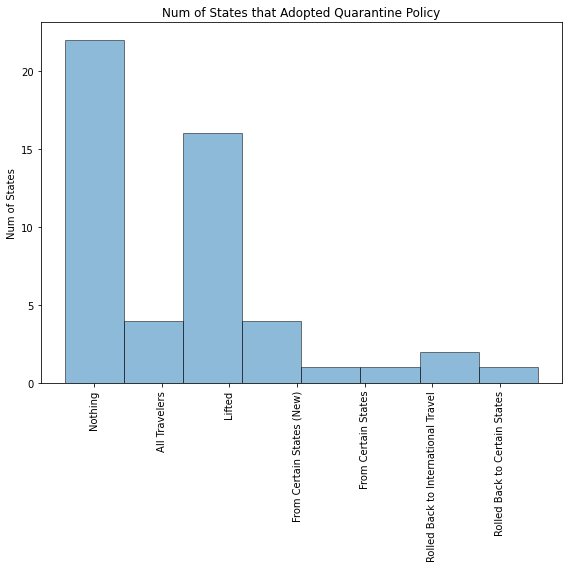

In [ ]:
fig = plt.figure(figsize = (8,8))
plt.hist(quarantine['2020-11-13']["Mandatory Quarantine for Travelers"], 
         align = "left", alpha=0.5, histtype='bar', ec='black',bins = 8)
plt.xticks(rotation=90)
plt.ylabel("Num of States")
plt.title("Num of States that Adopted Quarantine Policy")
plt.tight_layout()
plt.savefig("../graphs/Num of States that Adopted Quarantine Policy.png", dpi = 100)

In [ ]:
quarantine_df.head()

,Location,2020-06-04,2020-06-05,2020-06-08,2020-06-12,2020-06-15,2020-06-17,2020-06-22,2020-06-24,2020-06-25,...,2020-09-24,2020-10-01,2020-10-05,2020-10-22,2020-10-23,2020-10-27,2020-11-02,2020-11-06,2020-11-11,2020-11-13
0,Alabama,All Travelers,-,-,-,-,-,-,-,-,...,-,-,-,-,-,-,-,-,-,-
1,Alaska,Lifted,All Travelers,All Travelers,All Travelers,All Travelers,All Travelers,All Travelers,All Travelers,All Travelers,...,All Travelers,All Travelers,All Travelers,All Travelers,All Travelers,All Travelers,All Travelers,All Travelers,All Travelers,All Travelers
2,Arizona,From Certain States,Lifted,Lifted,Lifted,Lifted,Lifted,Lifted,Lifted,Lifted,...,Lifted,Lifted,Lifted,Lifted,Lifted,Lifted,Lifted,Lifted,Lifted,Lifted
3,Arkansas,-,From Certain States,From Certain States,From Certain States,Lifted,Lifted,Lifted,Lifted,Lifted,...,Lifted,Lifted,Lifted,Lifted,Lifted,Lifted,Lifted,Lifted,Lifted,Lifted
4,California,-,-,-,-,-,-,-,-,-,...,-,-,-,-,-,-,-,-,-,-


### b. Adapted from https://github.com/covidvis/covid19-vis

In [ ]:
# Import fisp file by Kieran Healy (@kjhealy) from github 
# To match state name with state code
state_name_code_path = "https://raw.githubusercontent.com/kjhealy/fips-codes/master/state_fips_master.csv"
state_name_code = pd.read_csv(state_name_code_path)
state_name_code.head()

,state_name,state_abbr,long_name,fips,sumlev,region,division,state,region_name,division_name
0,Alabama,AL,Alabama AL,1,40,3,6,1,South,East South Central
1,Alaska,AK,Alaska AK,2,40,4,9,2,West,Pacific
2,Arizona,AZ,Arizona AZ,4,40,4,8,4,West,Mountain
3,Arkansas,AR,Arkansas AR,5,40,3,7,5,South,West South Central
4,California,CA,California CA,6,40,4,9,6,West,Pacific


In [ ]:
policy_df = pd.read_csv("policy-data/quarantine-activity-US-Apr16-long.csv")
print(policy_df.shape)
print(policy_df.columns)

(607, 20)
Index(['State', 'Coverage.type', 'Coverage.location', 'Effective Date',
       'State of Emergency Declaration', 'Travel Restrictions',
       'Shelter-in-place Order', 'Gathering Limitations',
       'Banning Gatherings of a Certain Size', 'K-12 School Closure',
       'Bar and Dine-in Restaurant Closure',
       'Non-essential Businesses Closure', 'Details (if any)',
       'Reference links', 'Timestamp', 'population_size',
       'population_reference', 'Coverage.county.FIPS', 'Coverage.city.FIPS',
       'population_reference.1'],
      dtype='object')


In [ ]:
policy_df.head()

,State,Coverage.type,Coverage.location,Effective Date,State of Emergency Declaration,Travel Restrictions,Shelter-in-place Order,Gathering Limitations,Banning Gatherings of a Certain Size,K-12 School Closure,Bar and Dine-in Restaurant Closure,Non-essential Businesses Closure,Details (if any),Reference links,Timestamp,population_size,population_reference,Coverage.county.FIPS,Coverage.city.FIPS,population_reference.1
0,Alabama,State-wide,Alabama,3/13/20,State of Emergency declared,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,https://en.wikipedia.org/wiki/U.S._state_and_l...,4/10/20,4903185,1.0,NaN,NaN,https://www.census.gov/data/datasets/time-seri...
1,Alabama,State-wide,Alabama,3/27/20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Some (cherry-picked) businesses closed,"On March 27, all non-essential businesses"" in ...",https://en.wikipedia.org/wiki/2020_coronavirus...,4/10/20,4903185,1.0,NaN,NaN,https://www.census.gov/data/datasets/time-seri...
2,Alabama,State-wide,Alabama,3/2/20,NaN,NaN,NaN,Suggested social distancing,NaN,NaN,NaN,NaN,"On March 2, the Alabama Department of Public H...",https://en.wikipedia.org/wiki/2020_coronavirus...,4/10/20,4903185,1.0,NaN,NaN,https://www.census.gov/data/datasets/time-seri...
3,Alabama,State-wide,Alabama,4/4/20,NaN,NaN,Shelter-in-place order,NaN,NaN,NaN,NaN,NaN,"On April 3, Governor Ivey issued a statewide s...",https://en.wikipedia.org/wiki/2020_coronavirus...,4/10/20,4903185,1.0,NaN,NaN,https://www.census.gov/data/datasets/time-seri...
4,Alabama,State-wide,Alabama,3/18/20,NaN,NaN,NaN,Banned gatherings of a certain size,50.0,Schools closed,NaN,NaN,"On March 12, all schools were closed from Marc...",https://en.wikipedia.org/wiki/2020_coronavirus...,4/10/20,4903185,1.0,NaN,NaN,https://www.census.gov/data/datasets/time-seri...


In [ ]:
policies = ['Travel Restrictions',
       'Shelter-in-place Order', 'Gathering Limitations',
       'Banning Gatherings of a Certain Size', 'K-12 School Closure',
       'Bar and Dine-in Restaurant Closure',
       'Non-essential Businesses Closure']

In [ ]:
policy_state_dfs = []
for policy in policies:
    cur_df = policy_df[~policy_df[policy].isna()].reset_index(drop = True)
    cur_df = cur_df[cur_df["Coverage.type"] == "State-wide"]
    cur_df = cur_df.merge(state_name_code, left_on = "State",
                    right_on="state_name", how = "inner")
    cur_df = cur_df[['State', 'Coverage.type', 'Coverage.location', 'Effective Date',
                 'State of Emergency Declaration','Details (if any)',
                'Reference links', 'Timestamp', 'population_size',
                'population_reference', 'state_name', 'state_abbr', 'fips', ]]

    
    policy_state_dfs.append(cur_df)
    print(policy, ":" ,len(cur_df))

Travel Restrictions : 9
Shelter-in-place Order : 39
Gathering Limitations : 35
Banning Gatherings of a Certain Size : 32
K-12 School Closure : 42
Bar and Dine-in Restaurant Closure : 20
Non-essential Businesses Closure : 25


In [ ]:
data_all["state_2020"].head()

,level,date,state_fips,state_code,county_fips,county,pop_stay_at_home,pop_not_stay_at_home,trips,trips_1,...,trips_25_50,trips_50_100,trips_100_250,trips_250_500,trips_500,only_date,weekday,pop,avg_stay_at_home_ratio,MA_7
0,State,2020-01-01,33.0,NH,NaN,NaN,344486.0,1011972.0,4032895.0,809618.0,...,247609.0,90286.0,20108.0,2674.0,1999.0,01/01,2,1356458.0,0.253960,0.253960
1,State,2020-01-01,6.0,CA,NaN,NaN,9219703.0,30337342.0,112606885.0,31144582.0,...,5553845.0,2217442.0,839553.0,174752.0,89345.0,01/01,2,39557045.0,0.233074,0.233074
2,State,2020-01-01,8.0,CO,NaN,NaN,1534420.0,4161144.0,18346137.0,4641274.0,...,807692.0,352436.0,141931.0,39387.0,32530.0,01/01,2,5695564.0,0.269406,0.269406
3,State,2020-01-01,9.0,CT,NaN,NaN,919958.0,2652707.0,9636627.0,2187052.0,...,464270.0,186371.0,49982.0,10008.0,10830.0,01/01,2,3572665.0,0.257499,0.257499
4,State,2020-01-01,10.0,DE,NaN,NaN,248781.0,718390.0,2665377.0,643220.0,...,140146.0,47470.0,15988.0,1121.0,1062.0,01/01,2,967171.0,0.257225,0.257225


In [ ]:
#Travel Restrictions
policy_state_dfs[0].head()

,State,Coverage.type,Coverage.location,Effective Date,State of Emergency Declaration,Details (if any),Reference links,Timestamp,population_size,population_reference,state_name,state_abbr,fips
0,Alaska,State-wide,Alaska,3/25/20,NaN,Mike Dunleavy ordered everyone arriving in Ala...,https://en.wikipedia.org/wiki/2020_coronavirus...,4/10/20,731545,2.0,Alaska,AK,2
1,Florida,State-wide,Florida,3/24/20,NaN,"On March 27, DeSantis expanded a previous orde...",https://www.usatoday.com/story/travel/airline-...,4/11/20,21477737,12.0,Florida,FL,12
2,Hawaii,State-wide,Hawaii,3/21/20,NaN,"On March 21, Ige ordered a 14-day mandatory qu...",https://en.wikipedia.org/wiki/U.S._state_and_l...,4/11/20,1415872,15.0,Hawaii,HI,15
3,Kentucky,State-wide,Kentucky,4/1/20,NaN,April 1 ‚Äì Gov. Beshear ordered Kentucky resi...,https://en.wikipedia.org/wiki/U.S._state_and_l...,4/11/20,4467673,21.0,Kentucky,KY,21
4,Massachusetts,State-wide,Massachusetts,3/27/20,NaN,"On March 27, Governor Baker asked travelers fr...",https://en.wikipedia.org/wiki/2020_coronavirus...,4/14/20,6892503,25.0,Massachusetts,MA,25


In [ ]:
policy_state_df = policy_state_dfs[0]
policy_date = datetime.datetime.strptime(policy_state_df["Effective Date"][2]+"20","%m/%d/%Y")

policy_date

datetime.datetime(2020, 3, 21, 0, 0)

In [ ]:
np.ceil(10/3)

4.0

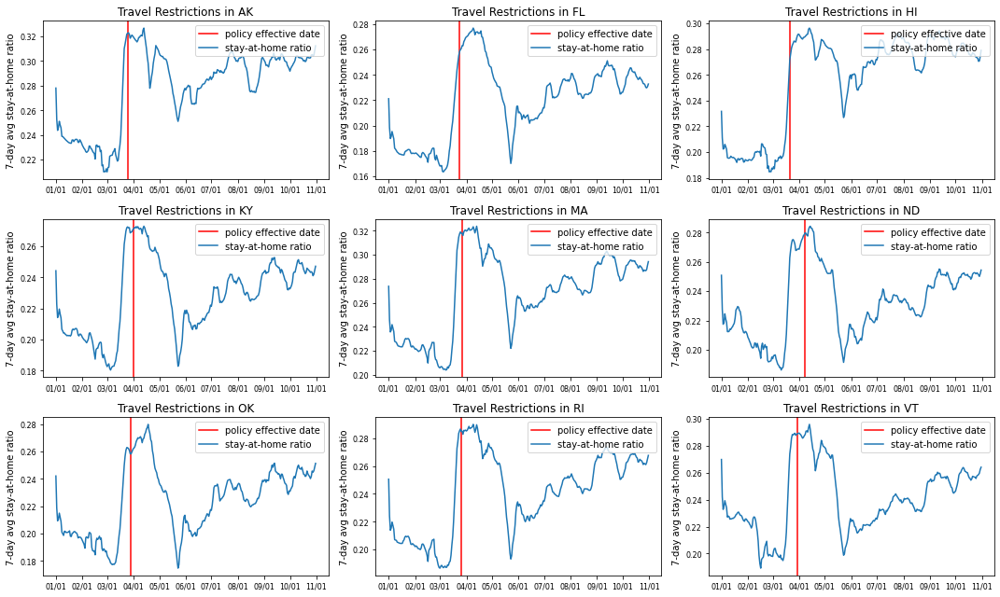

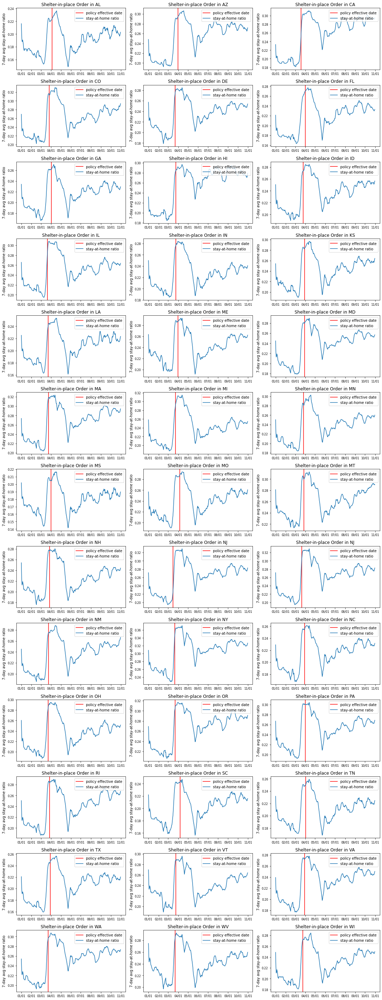

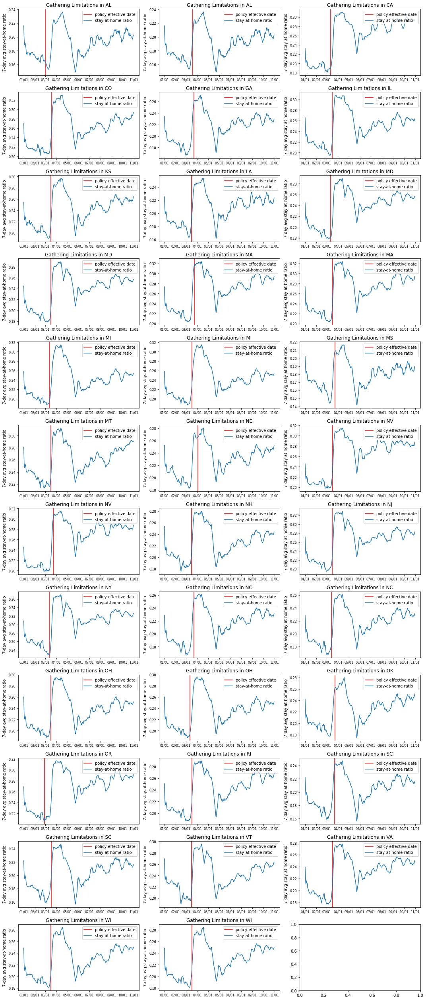

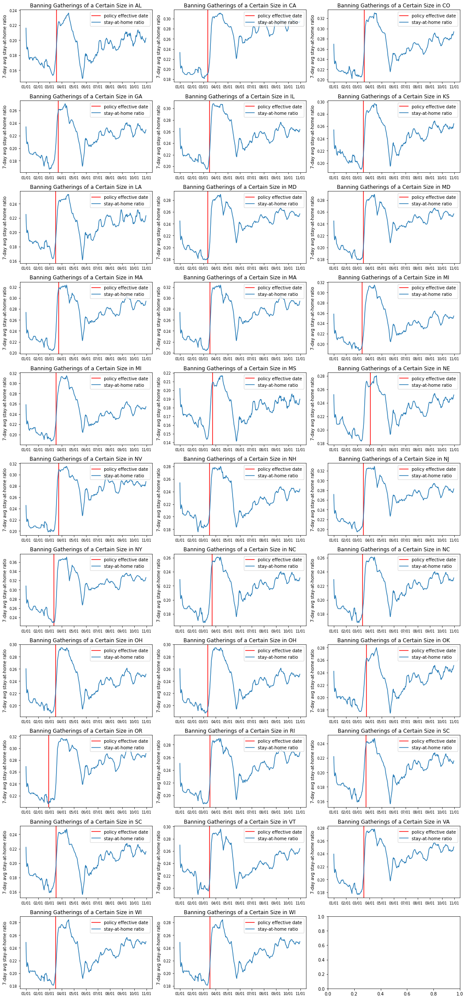

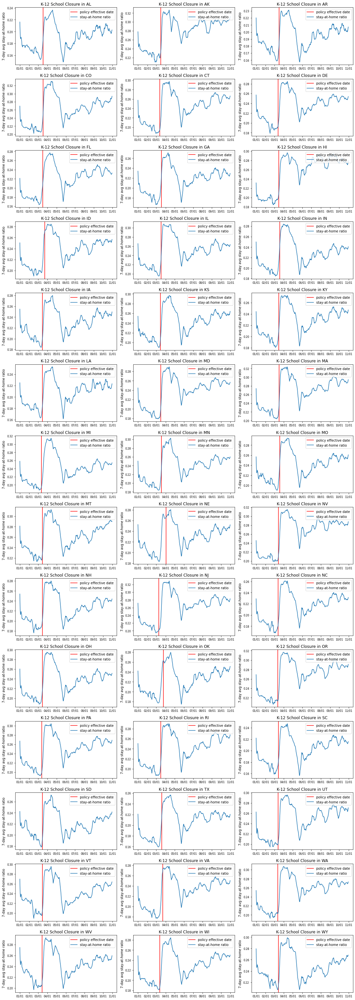

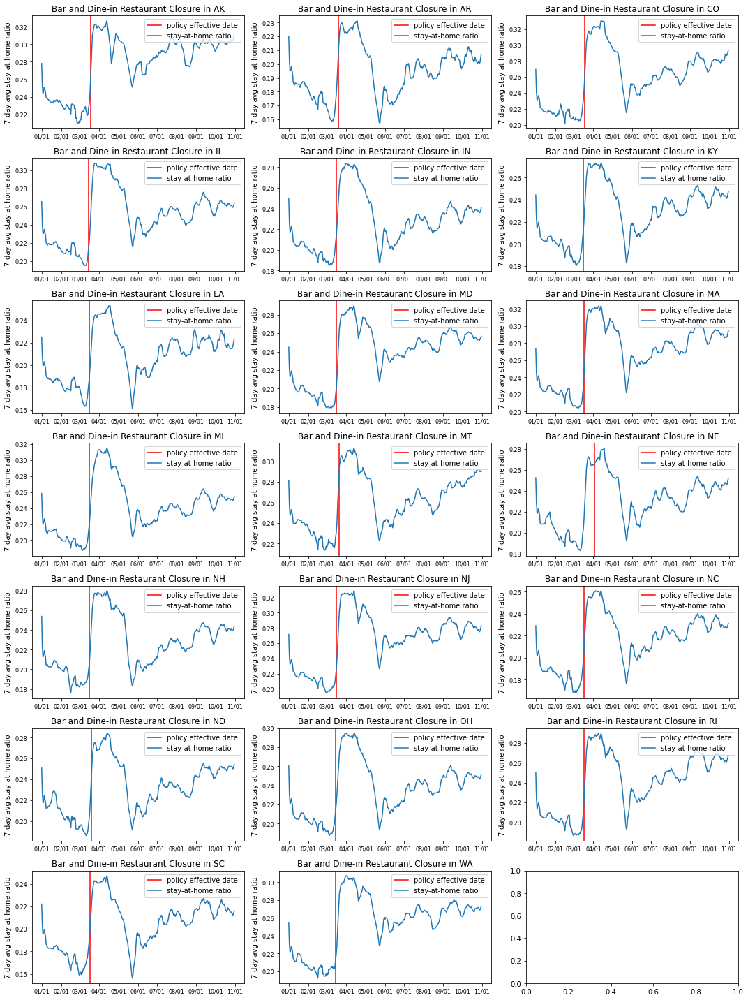

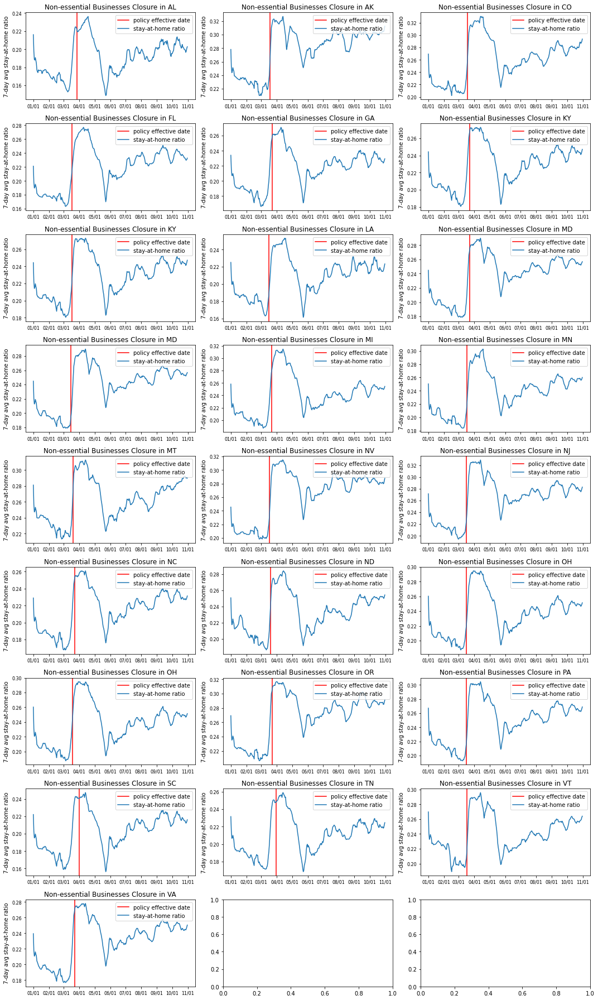

In [ ]:
state_df = data_all["state_2020"]
converted_dates = list(map(datetime.datetime.strptime, data_all["national_2020"]["date"].values, len(data_all["national_2020"]["date"].values)*['%Y-%m-%d']))

for k in range(len(policies)):
    policy = policies[k]
    policy_state_df = policy_state_dfs[k]
    
    fig, axs = plt.subplots(int(np.ceil(len(policy_state_df)/3)), 3, figsize = (15,1*len(policy_state_df)))
    i = 0
    state_names = policy_state_df["state_abbr"].values

    for ax in axs.ravel():
        if i == len(policy_state_df):
            break

        state = state_names[i]
        policy_date = datetime.datetime.strptime(policy_state_df["Effective Date"][i]+"20","%m/%d/%Y")

        ax.xaxis.set_major_formatter(mdates.DateFormatter('%m/%d'))
        ax.tick_params(axis='both', which='major', labelsize=8)
    
        cur_state = state_df[state_df["state_code"] == state_names[i]]
    
        ax.set_title("%s in %s"%(policy, str(state_names[i])))

        ax.axvline(x=policy_date, label = "policy effective date", color = "r")
        ax.plot(converted_dates, cur_state["MA_7"], label = 'stay-at-home ratio')
        ax.legend(loc = "upper right")
        ax.set_ylabel("7-day avg stay-at-home ratio")

        i += 1
    
     
    plt.tight_layout()
    fig.savefig("../graphs/%s and SAT ratio.png"%(policy), dpi = 100)

In [ ]:
len(policies)

7

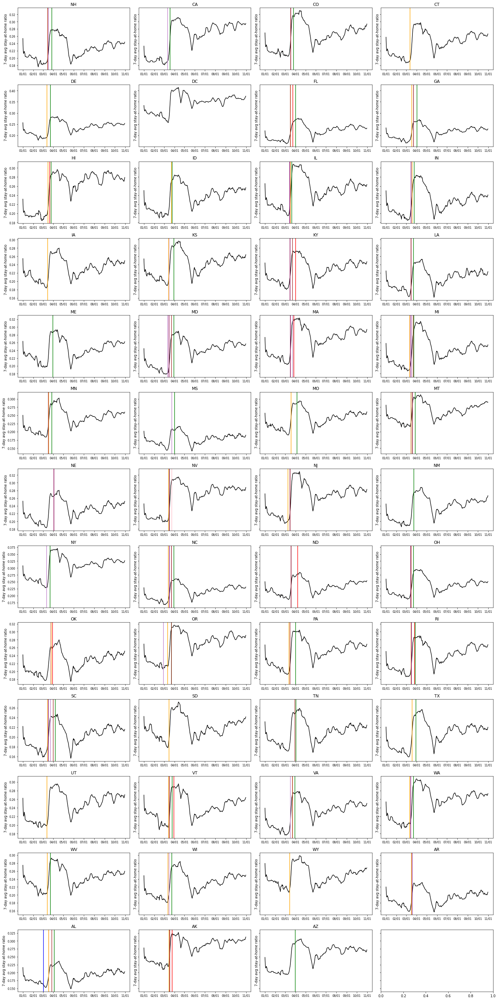

In [ ]:
state_df = data_all["state_2020"]
state_names = state_df["state_code"].unique()
colors = ["red", "green","blue","pink", "orange","purple","brown"]
converted_dates = list(map(datetime.datetime.strptime, data_all["national_2020"]["date"].values, len(data_all["national_2020"]["date"].values)*['%Y-%m-%d']))

fig, axs = plt.subplots(13, 4, figsize = (20,40),sharey='row')
i = 0
for ax in axs.ravel():
    if i == len(state_names):
        break

    cur_state = state_names[i]
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%m/%d'))
    ax.tick_params(axis='both', which='major', labelsize=8)
    
    cur_df = state_df[state_df["state_code"] == cur_state]
    ax.set_title("%s"%(str(cur_state)))

    # ax.plot(dates, cur_df['avg_stay_at_home_ratio'], label = "daily")
    ax.plot(converted_dates, cur_df["MA_7"], label = 'stay-at-home ratio',color = "black")
    
    for k in range(len(policies)):
        policy = policies[k]
        policy_state_df = policy_state_dfs[k]
        policy_states = policy_state_df["state_abbr"].values
        if cur_state in policy_states:
            index_ = list(policy_states).index(cur_state)
            policy_date = datetime.datetime.strptime(policy_state_df["Effective Date"][index_]+"20","%m/%d/%Y")
            ax.axvline(x=policy_date, label = "%s"%(policy), color = colors[k])
        

    # ax.legend(loc = "upper right")
    ax.set_ylabel("7-day avg stay-at-home ratio")
      
    i += 1

# ax.legend(bbox_to_anchor=(1.05, 0), loc='lower left', borderaxespad=0.)

# lines_labels = [ax.get_legend_handles_labels() for ax in fig.axes])
# lines, labels = list(set([sum(lol, []) for lol in zip(*lines_labels)]))

# fig.legend()
plt.tight_layout()
fig.savefig("../graphs/policies vs SAT ratio.png")

NameError: name 'case_state_name' is not defined

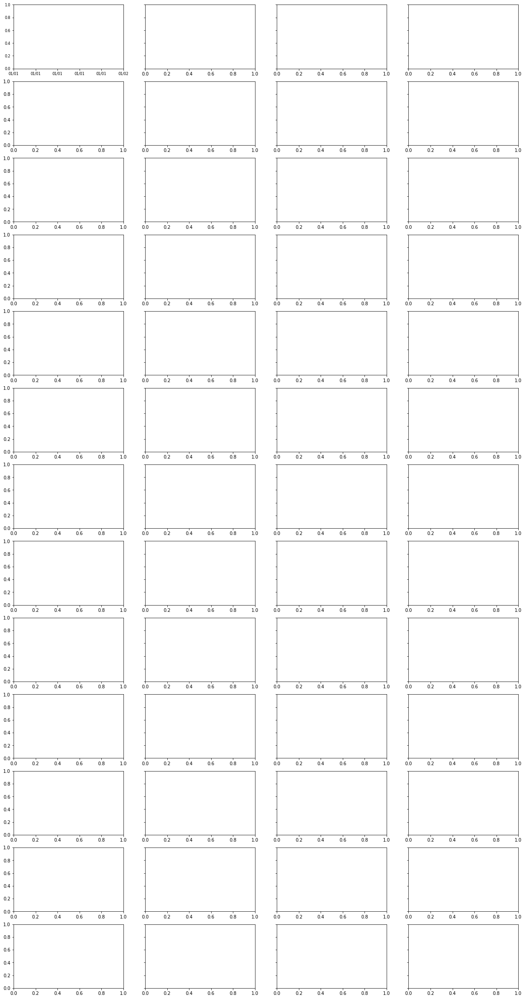

In [ ]:
# Time-series visualization for the US and each state
colors = ["red", "green","blue","pink", "orange","purple","brown"]
fig, axs = plt.subplots(13, 4, figsize = (20,40),sharey='row')
i = 0

for ax in axs.ravel()[0:51]:
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%m/%d'))
    
    ax.tick_params(axis='both', which='major', labelsize=8)
    ax.set_title("%s"%(str(case_state_name[i])))
    ax.plot(case_state_date, case_state_num.iloc[i,:], color = black)
    
    ax.set_ylabel("new confirmed cases")

    for k in range(len(policies)):
        policy = policies[k]
        policy_state_df = policy_state_dfs[k]
        policy_states = policy_state_df["state_abbr"].values
        if cur_state in policy_states:
            index_ = list(policy_states).index(cur_state)
            policy_date = datetime.datetime.strptime(policy_state_df["Effective Date"][index_]+"20","%m/%d/%Y")
            ax.axvline(x=policy_date, label = "%s"%(policy), color = colors[k])
     
      
    i += 1
     
plt.tight_layout()
fig.savefig("../graphs/policies and new confirmed cases")

# Social Economics Data

In [ ]:
case.head()

,countyFIPS,County Name,State,stateFIPS,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,...,11/1/20,11/2/20,11/3/20,11/4/20,11/5/20,11/6/20,11/7/20,11/8/20,11/9/20,fip
0,0,Statewide Unallocated,AL,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,00000
1,1001,Autauga County,AL,1,0,0,0,0,0,0,...,2173,2186,2197,2212,2230,2242,2267,2283,2304,01001
2,1003,Baldwin County,AL,1,0,0,0,0,0,0,...,6966,6985,6995,7061,7097,7134,7188,7226,7263,01003
3,1005,Barbour County,AL,1,0,0,0,0,0,0,...,1061,1065,1074,1079,1080,1090,1092,1095,1098,01005
4,1007,Bibb County,AL,1,0,0,0,0,0,0,...,878,883,890,897,907,917,924,926,932,01007


In [ ]:
social_data = pd.read_csv('../data/social_data/ACSDP5Y2018.DP02_data_with_overlays_2020-10-12T093324.csv')
social_data.head()

/opt/venv/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3147: DtypeWarning:

Columns (2,3,4,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,62,63,66,67,68,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,146,147,148,149,150,151,154,155,158,159,162,163,166,167,170,171,172,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,198,199,202,203,206,207,208,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,274,275,276,277,278,2

,GEO_ID,NAME,DP02_0001E,DP02_0001M,DP02_0001PE,DP02_0001PM,DP02_0002E,DP02_0002M,DP02_0002PE,DP02_0002PM,...,DP02_0123E,DP02_0123M,DP02_0123PE,DP02_0123PM,DP02_0124E,DP02_0124M,DP02_0124PE,DP02_0124PM,DP02_0125E,DP02_0125M
0,id,Geographic Area Name,Estimate!!HOUSEHOLDS BY TYPE!!Total households,Margin of Error!!HOUSEHOLDS BY TYPE!!Total hou...,Percent Estimate!!HOUSEHOLDS BY TYPE!!Total ho...,Percent Margin of Error!!HOUSEHOLDS BY TYPE!!T...,Estimate!!HOUSEHOLDS BY TYPE!!Total households...,Margin of Error!!HOUSEHOLDS BY TYPE!!Total hou...,Percent Estimate!!HOUSEHOLDS BY TYPE!!Total ho...,Percent Margin of Error!!HOUSEHOLDS BY TYPE!!T...,...,Estimate!!ANCESTRY!!Total population!!American,Margin of Error!!ANCESTRY!!Total population!!A...,Percent Estimate!!ANCESTRY!!Total population!!...,Percent Margin of Error!!ANCESTRY!!Total popul...,Estimate!!ANCESTRY!!Total population!!Arab,Margin of Error!!ANCESTRY!!Total population!!Arab,Percent Estimate!!ANCESTRY!!Total population!!...,Percent Margin of Error!!ANCESTRY!!Total popul...,Estimate!!ANCESTRY!!Total population!!Czech,Margin of Error!!ANCESTRY!!Total population!!C...
1,0500000US01001,"Autauga County, Alabama",21115,383,21115,(X),15161,488,71.8,2.3,...,8074,1129,14.6,2.0,39,58,0.1,0.1,50,46
2,0500000US01003,"Baldwin County, Alabama",78622,1183,78622,(X),51359,1309,65.3,1.4,...,54340,3115,26.1,1.5,791,586,0.4,0.3,873,259
3,0500000US01005,"Barbour County, Alabama",9186,280,9186,(X),6030,284,65.6,2.7,...,3695,413,14.3,1.6,19,18,0.1,0.1,0,22
4,0500000US01007,"Bibb County, Alabama",6840,321,6840,(X),4947,366,72.3,3.7,...,2648,641,11.8,2.8,8,16,0.0,0.1,0,22


In [ ]:
eco_data =  pd.read_csv('../data/eco_data/ACSDP5Y2018.DP03_data_with_overlays_2020-11-09T135613.csv')
eco_data.head()

/opt/venv/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3147: DtypeWarning:

Columns (2,3,4,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,36,37,38,39,40,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,58,59,60,61,62,63,64,66,67,68,69,70,71,72,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,102,103,104,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,250,251,254,255,256,257,258,259,262,263,264,265,266,267,270,271,272,

,GEO_ID,NAME,DP03_0001E,DP03_0001M,DP03_0001PE,DP03_0001PM,DP03_0002E,DP03_0002M,DP03_0002PE,DP03_0002PM,...,DP03_0123E,DP03_0123M,DP03_0123PE,DP03_0123PM,DP03_0124E,DP03_0124M,DP03_0124PE,DP03_0124PM,DP03_0125E,DP03_0125M
0,id,Geographic Area Name,Estimate!!EMPLOYMENT STATUS!!Population 16 yea...,Margin of Error!!EMPLOYMENT STATUS!!Population...,Percent Estimate!!EMPLOYMENT STATUS!!Populatio...,Percent Margin of Error!!EMPLOYMENT STATUS!!Po...,Estimate!!EMPLOYMENT STATUS!!Population 16 yea...,Margin of Error!!EMPLOYMENT STATUS!!Population...,Percent Estimate!!EMPLOYMENT STATUS!!Populatio...,Percent Margin of Error!!EMPLOYMENT STATUS!!Po...,...,Estimate!!PERCENTAGE OF FAMILIES AND PEOPLE WH...,Margin of Error!!PERCENTAGE OF FAMILIES AND PE...,Percent Estimate!!PERCENTAGE OF FAMILIES AND P...,Percent Margin of Error!!PERCENTAGE OF FAMILIE...,Estimate!!PERCENTAGE OF FAMILIES AND PEOPLE WH...,Margin of Error!!PERCENTAGE OF FAMILIES AND PE...,Percent Estimate!!PERCENTAGE OF FAMILIES AND P...,Percent Margin of Error!!PERCENTAGE OF FAMILIE...,Estimate!!PERCENTAGE OF FAMILIES AND PEOPLE WH...,Margin of Error!!PERCENTAGE OF FAMILIES AND PE...
1,0500000US01001,"Autauga County, Alabama",43368,203,43368,(X),25736,653,59.3,1.6,...,(X),(X),7.8,3.0,(X),(X),0.9,1.4,(X),(X)
2,0500000US01003,"Baldwin County, Alabama",167712,321,167712,(X),98030,1549,58.5,0.9,...,(X),(X),4.4,1.2,(X),(X),5.0,4.1,(X),(X)
3,0500000US01005,"Barbour County, Alabama",20948,82,20948,(X),9638,434,46.0,2.0,...,(X),(X),14.4,5.6,(X),(X),17.3,14.7,(X),(X)
4,0500000US01007,"Bibb County, Alabama",18470,132,18470,(X),8757,521,47.4,2.8,...,(X),(X),4.9,4.3,(X),(X),0.0,22.3,(X),(X)


In [ ]:
social_data.columns = social_data.iloc[0,:]
social_data = social_data[1:]

eco_data.columns = eco_data.iloc[0,:]
eco_data = eco_data[1:]

display(social_data.head())
display(eco_data.head())

,id,Geographic Area Name,Estimate!!HOUSEHOLDS BY TYPE!!Total households,Margin of Error!!HOUSEHOLDS BY TYPE!!Total households,Percent Estimate!!HOUSEHOLDS BY TYPE!!Total households,Percent Margin of Error!!HOUSEHOLDS BY TYPE!!Total households,Estimate!!HOUSEHOLDS BY TYPE!!Total households!!Family households (families),Margin of Error!!HOUSEHOLDS BY TYPE!!Total households!!Family households (families),Percent Estimate!!HOUSEHOLDS BY TYPE!!Total households!!Family households (families),Percent Margin of Error!!HOUSEHOLDS BY TYPE!!Total households!!Family households (families),...,Estimate!!ANCESTRY!!Total population!!American,Margin of Error!!ANCESTRY!!Total population!!American,Percent Estimate!!ANCESTRY!!Total population!!American,Percent Margin of Error!!ANCESTRY!!Total population!!American,Estimate!!ANCESTRY!!Total population!!Arab,Margin of Error!!ANCESTRY!!Total population!!Arab,Percent Estimate!!ANCESTRY!!Total population!!Arab,Percent Margin of Error!!ANCESTRY!!Total population!!Arab,Estimate!!ANCESTRY!!Total population!!Czech,Margin of Error!!ANCESTRY!!Total population!!Czech
1,0500000US01001,"Autauga County, Alabama",21115,383,21115,(X),15161,488,71.8,2.3,...,8074,1129,14.6,2.0,39,58,0.1,0.1,50,46
2,0500000US01003,"Baldwin County, Alabama",78622,1183,78622,(X),51359,1309,65.3,1.4,...,54340,3115,26.1,1.5,791,586,0.4,0.3,873,259
3,0500000US01005,"Barbour County, Alabama",9186,280,9186,(X),6030,284,65.6,2.7,...,3695,413,14.3,1.6,19,18,0.1,0.1,0,22
4,0500000US01007,"Bibb County, Alabama",6840,321,6840,(X),4947,366,72.3,3.7,...,2648,641,11.8,2.8,8,16,0.0,0.1,0,22
5,0500000US01009,"Blount County, Alabama",20600,396,20600,(X),15104,429,73.3,2.0,...,7948,905,13.8,1.6,3,7,0.0,0.1,1,2


,id,Geographic Area Name,Estimate!!EMPLOYMENT STATUS!!Population 16 years and over,Margin of Error!!EMPLOYMENT STATUS!!Population 16 years and over,Percent Estimate!!EMPLOYMENT STATUS!!Population 16 years and over,Percent Margin of Error!!EMPLOYMENT STATUS!!Population 16 years and over,Estimate!!EMPLOYMENT STATUS!!Population 16 years and over!!In labor force,Margin of Error!!EMPLOYMENT STATUS!!Population 16 years and over!!In labor force,Percent Estimate!!EMPLOYMENT STATUS!!Population 16 years and over!!In labor force,Percent Margin of Error!!EMPLOYMENT STATUS!!Population 16 years and over!!In labor force,...,Estimate!!PERCENTAGE OF FAMILIES AND PEOPLE WHOSE INCOME IN THE PAST 12 MONTHS IS BELOW THE POVERTY LEVEL!!Married couple families!!With related children of the householder under 18 years,Margin of Error!!PERCENTAGE OF FAMILIES AND PEOPLE WHOSE INCOME IN THE PAST 12 MONTHS IS BELOW THE POVERTY LEVEL!!Married couple families!!With related children of the householder under 18 years,Percent Estimate!!PERCENTAGE OF FAMILIES AND PEOPLE WHOSE INCOME IN THE PAST 12 MONTHS IS BELOW THE POVERTY LEVEL!!Married couple families!!With related children of the householder under 18 years,Percent Margin of Error!!PERCENTAGE OF FAMILIES AND PEOPLE WHOSE INCOME IN THE PAST 12 MONTHS IS BELOW THE POVERTY LEVEL!!Married couple families!!With related children of the householder under 18 years,Estimate!!PERCENTAGE OF FAMILIES AND PEOPLE WHOSE INCOME IN THE PAST 12 MONTHS IS BELOW THE POVERTY LEVEL!!Married couple families!!With related children of the householder under 18 years!!With related children of the householder under 5 years only,Margin of Error!!PERCENTAGE OF FAMILIES AND PEOPLE WHOSE INCOME IN THE PAST 12 MONTHS IS BELOW THE POVERTY LEVEL!!Married couple families!!With related children of the householder under 18 years!!With related children of the householder under 5 years only,Percent Estimate!!PERCENTAGE OF FAMILIES AND PEOPLE WHOSE INCOME IN THE PAST 12 MONTHS IS BELOW THE POVERTY LEVEL!!Married couple families!!With related children of the householder under 18 years!!With related children of the householder under 5 years only,Percent Margin of Error!!PERCENTAGE OF FAMILIES AND PEOPLE WHOSE INCOME IN THE PAST 12 MONTHS IS BELOW THE POVERTY LEVEL!!Married couple families!!With related children of the householder under 18 years!!With related children of the householder under 5 years only,"Estimate!!PERCENTAGE OF FAMILIES AND PEOPLE WHOSE INCOME IN THE PAST 12 MONTHS IS BELOW THE POVERTY LEVEL!!Families with female householder, no husband present","Margin of Error!!PERCENTAGE OF FAMILIES AND PEOPLE WHOSE INCOME IN THE PAST 12 MONTHS IS BELOW THE POVERTY LEVEL!!Families with female householder, no husband present"
1,0500000US01001,"Autauga County, Alabama",43368,203,43368,(X),25736,653,59.3,1.6,...,(X),(X),7.8,3.0,(X),(X),0.9,1.4,(X),(X)
2,0500000US01003,"Baldwin County, Alabama",167712,321,167712,(X),98030,1549,58.5,0.9,...,(X),(X),4.4,1.2,(X),(X),5.0,4.1,(X),(X)
3,0500000US01005,"Barbour County, Alabama",20948,82,20948,(X),9638,434,46.0,2.0,...,(X),(X),14.4,5.6,(X),(X),17.3,14.7,(X),(X)
4,0500000US01007,"Bibb County, Alabama",18470,132,18470,(X),8757,521,47.4,2.8,...,(X),(X),4.9,4.3,(X),(X),0.0,22.3,(X),(X)
5,0500000US01009,"Blount County, Alabama",45915,159,45915,(X),22306,734,48.6,1.6,...,(X),(X),9.9,2.9,(X),(X),4.0,2.8,(X),(X)


In [ ]:
social_eco = pd.merge(social_data, eco_data, on=['id','Geographic Area Name'])
print('shape of social data:',social_data.shape)
print('shape of eco data:',eco_data.shape)
print('shape of merged data:',social_eco.shape)

shape of social data: (3220, 610)
shape of eco data: (3220, 550)
shape of merged data: (3220, 1158)


In [ ]:
social_eco['fip']=social_eco['id'].apply(lambda x:x[-5:])
social_eco.describe()

,id,Geographic Area Name,Estimate!!HOUSEHOLDS BY TYPE!!Total households,Margin of Error!!HOUSEHOLDS BY TYPE!!Total households,Percent Estimate!!HOUSEHOLDS BY TYPE!!Total households,Percent Margin of Error!!HOUSEHOLDS BY TYPE!!Total households,Estimate!!HOUSEHOLDS BY TYPE!!Total households!!Family households (families),Margin of Error!!HOUSEHOLDS BY TYPE!!Total households!!Family households (families),Percent Estimate!!HOUSEHOLDS BY TYPE!!Total households!!Family households (families),Percent Margin of Error!!HOUSEHOLDS BY TYPE!!Total households!!Family households (families),...,Estimate!!ANCESTRY!!Total population!!American,Margin of Error!!ANCESTRY!!Total population!!American,Percent Estimate!!ANCESTRY!!Total population!!American,Percent Margin of Error!!ANCESTRY!!Total population!!American,Estimate!!ANCESTRY!!Total population!!Arab,Margin of Error!!ANCESTRY!!Total population!!Arab,Percent Estimate!!ANCESTRY!!Total population!!Arab,Percent Margin of Error!!ANCESTRY!!Total population!!Arab,Estimate!!ANCESTRY!!Total population!!Czech,Margin of Error!!ANCESTRY!!Total population!!Czech
count,3220,3220,3142,3142,3142,3142,3142,3142,3142.0,3142.0,...,3142,3142,3142.0,3142.0,3142,3142,3142.0,3142.0,3142,3142
unique,3220,3220,3048,1315,3048,1,3013,1446,525.0,183.0,...,2777,1802,571.0,131.0,904,767,45.0,74.0,1147,702
top,0500000US48433,"Charlottesville city, Virginia",1055,90,1055,(X),2778,191,66.5,1.7,...,100,171,3.7,0.9,0,9,0.0,0.1,0,19
freq,1,1,3,12,3,3142,3,11,30.0,67.0,...,6,9,32.0,117.0,548,105,791.0,964.0,272,64


We find that all the columns are object type, so next we will do some data cleaning to remove rows which contains nan and cols whcich contain string.

In [ ]:
social_eco = social_eco.dropna(axis=0,how='any')

# only select cols that are 'estimate' rather than 'margin of error'
social_eco = social_eco[social_eco.columns[pd.Series(social_eco.columns).str.startswith('Estimate')]]
print('cols that are estimates:',social_eco.shape)

# remove cols that contain string
discard_col = []
for col in social_eco.columns:
    try:
        social_eco[col] = social_eco[col].astype(int)
    except:
        discard_col.append(col)

useful_cols = list(set(social_eco.columns)-set(discard_col))
print('useful columns length:',len(useful_cols))

cols that are estimates: (3142, 289)
useful columns length: 146


In [ ]:
social_eco_clean = social_eco[useful_cols]
social_eco_clean.describe()

,Estimate!!MARITAL STATUS!!Females 15 years and over!!Never married,Estimate!!HOUSEHOLDS BY TYPE!!Total households!!Family households (families)!!With own children of the householder under 18 years,Estimate!!ANCESTRY!!Total population!!Czech,"Estimate!!LANGUAGE SPOKEN AT HOME!!Population 5 years and over!!Asian and Pacific Islander languages!!Speak English less than very well""""",Estimate!!HEALTH INSURANCE COVERAGE!!Civilian noninstitutionalized population!!No health insurance coverage,"Estimate!!EDUCATIONAL ATTAINMENT!!Population 25 years and over!!Some college, no degree",Estimate!!HOUSEHOLDS BY TYPE!!Total households!!Family households (families)!!Married-couple family!!With own children of the householder under 18 years,Estimate!!EDUCATIONAL ATTAINMENT!!Population 25 years and over!!Graduate or professional degree,"Estimate!!PLACE OF BIRTH!!Total population!!Native!!Born in Puerto Rico, U.S. Island areas, or born abroad to American parent(s)",Estimate!!DISABILITY STATUS OF THE CIVILIAN NONINSTITUTIONALIZED POPULATION!!65 years and over!!With a disability,...,Estimate!!ANCESTRY!!Total population!!Russian,"Estimate!!MARITAL STATUS!!Males 15 years and over!!Now married, except separated",Estimate!!DISABILITY STATUS OF THE CIVILIAN NONINSTITUTIONALIZED POPULATION!!Total Civilian Noninstitutionalized Population!!With a disability,Estimate!!ANCESTRY!!Total population!!Dutch,Estimate!!HEALTH INSURANCE COVERAGE!!Civilian noninstitutionalized population!!With health insurance coverage!!With public coverage,Estimate!!GRANDPARENTS!!Number of grandparents living with own grandchildren under 18 years!!Grandparents responsible for grandchildren,Estimate!!ANCESTRY!!Total population!!Polish,Estimate!!YEAR OF ENTRY!!Population born outside the United States!!Native!!Entered 2010 or later,Estimate!!PLACE OF BIRTH!!Total population!!Foreign born,Estimate!!U.S. CITIZENSHIP STATUS!!Foreign-born population!!Naturalized U.S. citizen
count,3.142000e+03,3142.000000,3142.000000,3142.000000,3.142000e+03,3.142000e+03,3142.000000,3142.000000,3142.000000,3142.000000,...,3142.000000,3.142000e+03,3142.000000,3142.000000,3.142000e+03,3142.000000,3142.000000,3142.000000,3.142000e+03,3.142000e+03
mean,1.290841e+04,10641.342775,440.112985,1562.160407,9.469372e+03,1.433079e+04,7237.563972,8401.057925,1600.357097,5336.086251,...,850.412158,2.025944e+04,12753.553787,1276.027689,3.506905e+04,802.331636,2913.055060,290.102482,1.385726e+04,6.763211e+03
std,4.886983e+04,33554.847414,1495.853021,13500.915549,3.783075e+04,4.419028e+04,22938.833865,31161.423828,6735.104311,15016.838799,...,4278.404347,6.109149e+04,34548.339730,3806.886390,1.147177e+05,2329.911057,12161.101838,1399.162343,9.180547e+04,4.727796e+04
min,0.000000e+00,0.000000,0.000000,0.000000,2.000000e+00,1.200000e+01,0.000000,0.000000,0.000000,5.000000,...,0.000000,1.100000e+01,17.000000,0.000000,1.400000e+01,0.000000,0.000000,0.000000,0.000000e+00,0.000000e+00
25%,9.472500e+02,1046.250000,14.000000,4.000000,9.755000e+02,1.629250e+03,689.000000,384.250000,44.000000,778.250000,...,13.000000,2.368250e+03,1743.250000,110.000000,4.348250e+03,96.000000,69.000000,0.000000,1.852500e+02,7.400000e+01
50%,2.434500e+03,2522.500000,68.500000,37.000000,2.402500e+03,3.727000e+03,1671.500000,1075.000000,148.000000,1775.500000,...,57.000000,5.362500e+03,4235.500000,332.500000,1.008750e+04,270.000000,261.000000,12.000000,6.460000e+02,2.520000e+02
75%,7.075750e+03,6868.500000,286.000000,209.000000,6.099750e+03,1.000675e+04,4628.000000,3737.500000,556.500000,4133.750000,...,270.000000,1.389000e+04,10367.500000,1023.500000,2.492750e+04,670.000000,1262.750000,83.000000,2.919000e+03,1.148000e+03
max,1.627334e+06,952402.000000,39054.000000,530642.000000,1.086657e+06,1.314543e+06,642979.000000,760639.000000,122975.000000,454812.000000,...,130336.000000,1.785936e+06,993035.000000,112324.000000,3.809323e+06,65596.000000,424777.000000,35961.000000,3.456956e+06,1.784088e+06
